In [1]:
import os,sys
import numpy as np
import xarray as xr
import zarr
# plot
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
from matplotlib.colors import Colormap

# plota
import matplotlib.pyplot as plt
from matplotlib.colors import Colormap
import matplotlib.colors as mcolors
import matplotlib.dates as mdates
import matplotlib.cm as cm
import matplotlib.dates as mdates
import matplotlib.ticker as mticker
from matplotlib.colors import from_levels_and_colors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
CB_colors = {
	'blue':	'#377eb8',
	'orange':  '#ff7f00',
	'green':   '#4daf4a',
	'pink':	'#f781bf',
	'brown':   '#a65628',
	'purple':  '#984ea3',
	'gray':	'#999999',
	'red': 	'#e41a1c',
	'yellow':  '#dede00'
}

# from dask.distributed import Client
import multiprocessing.popen_spawn_posix
from distributed import Client

c = Client()
c

Client Scheduler: tcp://127.0.0.1:46103 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 5 Cores: 10 Memory: 322.12 GB


In [2]:
dir_sc = os.environ['SCRATCH']
dir_work = os.environ['WORK']

diro = dir_work + "/ETUDE3/ENS_VAR_BUDGET/PLOTS/"

In [3]:
diri="/gpfswork/rech/cli/rcli002/eORCA025.L75/eORCA025.L75-I/"
mesh_hgr = xr.open_dataset(diri+'mesh_hgr.nc').squeeze()
tmask = mesh_hgr.tmask[0].drop_vars('nav_lev').drop_vars('time_counter')
nav_lon =  mesh_hgr.nav_lon
nav_lat =  mesh_hgr.nav_lat

centim = 1/2.54  # centimeters in inches
proj = ccrs.Robinson(central_longitude=200) #ccrs.Robinson()
crs = ccrs.PlateCarree()
crs
rivers = cartopy.feature.NaturalEarthFeature(category='physical', name='rivers_lake_centerlines',scale='50m',facecolor='none',edgecolor='b')
land  = cfeature.NaturalEarthFeature(name='land',scale='50m', category='physical',facecolor='grey')
label_style = {'size': 8, 'color': '#BDBDBD', 'weight': 'normal'}

lim_l4 = 20 # %
cmap34 = cm.RdYlBu_r 

In [4]:
nexp1 = "ES"

ds_simask = xr.open_zarr(dir_work+"/ETUDE3/ENS_VAR_BUDGET/raw_data/"+nexp1+"/"+nexp1+"_SIMASK15_E1980_2018.zarr").SIMASK15_E
sum_simsk = ds_simask.sum(('ens','time_counter')).compute()
si_mask_nexp1 = (sum_simsk.where(sum_simsk==390,0)/390)
si_mask_nexp1 = si_mask_nexp1.where(tmask)

In [5]:
dir_data = dir_work + "/ETUDE3/ENS_VAR_BUDGET/data4analyses/"
my_regions_masks = xr.open_zarr(dir_data+"my_regions_masks.zarr")

# load data and save COMP _depth perc forced RIVERS

In [6]:
def do_forced_RIVERS(COMP,dep):
    # load data
    dir_data = dir_work + "/ETUDE3/ENS_VAR_BUDGET/data4analyses/"
    nexp2 = "EAI"
    nexp3 = "ES"
    ds2 = xr.open_zarr(dir_data+nexp2+"/"+COMP+"/var_terms_39"+"_0_"+dep+".zarr")
    ds3 = xr.open_zarr(dir_data+nexp3+"/"+COMP+"/var_terms_39"+"_0_"+dep+".zarr")

    # compute the difference
    DIFFEAI_ES   = ds2 - ds3
    forced_var_DIFFEAI_ES = DIFFEAI_ES.forced_var
    forced_var_DIFF_perc_EAI_ES = (forced_var_DIFFEAI_ES / ds3.tot_var) *100
    return  forced_var_DIFF_perc_EAI_ES

In [19]:
# dir_data = dir_work + "/ETUDE3/ENS_VAR_BUDGET/data4analyses/"
# nexp2 = "EAI"
# nexp3 = "ES"
# COMP="HALO"
# dep="2000m"
# print(dir_data+nexp2+"/"+COMP+"/var_terms_39"+"_0_"+dep+".zarr")
# xr.open_zarr(dir_data+nexp2+"/"+COMP+"/var_terms_39"+"_0_"+dep+".zarr")

# do_forced_RIVERS("HALO","50m")

<xarray.DataArray (y: 1207, x: 1442)>
dask.array<mul, shape=(1207, 1442), dtype=float64, chunksize=(151, 361), chunktype=numpy.ndarray>
Dimensions without coordinates: y, x

In [7]:
# values for the manuscript
diri="/gpfswork/rech/cli/rcli002/eORCA025.L75/eORCA025.L75-I/"
mesh_hgr = xr.open_dataset(diri+'mesh_hgr.nc').squeeze()
tmask = mesh_hgr.tmask[0].drop_vars('nav_lev').drop_vars('time_counter')
nav_lon =  mesh_hgr.nav_lon
nav_lat =  mesh_hgr.nav_lat
e1t = mesh_hgr.e1t.fillna(0)
e2t = mesh_hgr.e2t.fillna(0)

mask_2use= my_regions_masks.mask_atl

cellArea = (e1t * e2t).load()
# masking the cells we ignore in this study (land and sea ice cells)
oceanArea = cellArea.where(mask_2use, drop=True)
totalOceanArea = oceanArea.sum()
Weight = oceanArea / totalOceanArea

In [8]:
print((do_forced_RIVERS("STERIC","50m").where(mask_2use, drop=True) *Weight).sum().values)
print((do_forced_RIVERS("STERIC","100m").where(mask_2use, drop=True) *Weight).sum().values)
print((do_forced_RIVERS("STERIC","300m").where(mask_2use, drop=True) *Weight).sum().values)
print((do_forced_RIVERS("STERIC","700m").where(mask_2use, drop=True) *Weight).sum().values)
print((do_forced_RIVERS("STERIC","2000m").where(mask_2use, drop=True) *Weight).sum().values)
print((do_forced_RIVERS("STERIC","bottom").where(mask_2use, drop=True) *Weight).sum().values)

5.599188976703539
6.459213925141699
7.491081654471287
6.935707470941816
6.62958466141806
5.447224233005315


# plot figure

In [8]:
COMP="HALO"

In [ ]:
fig, [(axa,axb,axc),(axd,axe,axf) ]= plt.subplots(2,3,figsize=(30,12),facecolor='white', dpi=300,subplot_kw={'projection': proj})
plt.subplots_adjust(wspace=0.15, hspace=0)

#axa.text(-0.14, 0.5, "Forced RIVERS 0-"+dep+" m", fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axa.transAxes)

axa.set_title("0-50 m", fontsize=24) 
axb.set_title("0-100 m", fontsize=24) 
axc.set_title("0-300 m", fontsize=24) 
axd.set_title("0-700 m", fontsize=24) 
axe.set_title("0-2000 m", fontsize=24) 
axf.set_title("full depth", fontsize=24)

axa.text(-0.02, 0.98, 'a)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axa.transAxes)
axb.text(-0.02, 0.98, 'b)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axb.transAxes)
axc.text(-0.02, 0.98, 'c)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axc.transAxes)
axd.text(-0.02, 0.98, 'd)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axd.transAxes)
axe.text(-0.02, 0.98, 'e)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axe.transAxes)
axf.text(-0.02, 0.98, 'f)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axf.transAxes)


for ax_name in [axa,axb,axc,axd,axe,axf]:
    # ax_name.coastlines()
    gl = ax_name.gridlines(color='k',alpha=0.5, linestyle='--',linewidth=0.33,lw=1,ls=':', draw_labels=True)#, y_inline=True,)
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = label_style; gl.ylabel_style = label_style
    ax_name.add_feature(land, edgecolor='black')
    clr2 = ax_name.add_feature(rivers,alpha=0.3,facecolor='none',edgecolor='blue',zorder=6)
    ax_name.contour(nav_lon,nav_lat,my_regions_masks.mask_atl,1,colors="k",transform=crs,zorder=6)
    ax_name.contour(nav_lon,nav_lat,my_regions_masks.mask_sea,1,colors="k",transform=crs,zorder=6)
    
    ax_name.contourf(nav_lon,nav_lat,si_mask_nexp1.where(si_mask_nexp1==0).where(nav_lon<0),1,colors=CB_colors['gray'], transform=crs, alpha=0.5)
    ax_name.contourf(nav_lon,nav_lat,si_mask_nexp1.where(si_mask_nexp1==0).where(nav_lon>0),1,colors=CB_colors['gray'],transform=crs, alpha=0.5)

#--------------------- premiere ligne  --------------------------------------
cs= axa.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS(COMP,"50m").where(si_mask_nexp1), shading='flat',cmap =cmap34, transform=crs,  vmin =-lim_l4, vmax=lim_l4)
cs= axb.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS(COMP,"100m").where(si_mask_nexp1), shading='flat',cmap =cmap34, transform=crs, vmin =-lim_l4, vmax=lim_l4)
cs= axc.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS(COMP,"300m").where(si_mask_nexp1), shading='flat',cmap = cmap34, transform=crs, vmin =-lim_l4, vmax=lim_l4)

#--------------------- deuxieme ligne  --------------------------------------
cs= axd.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS(COMP,"700m").where(si_mask_nexp1), shading='flat',cmap =cmap34, transform=crs,  vmin =-lim_l4, vmax=lim_l4)
cs= axe.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS(COMP,"2000m").where(si_mask_nexp1), shading='flat',cmap =cmap34, transform=crs, vmin =-lim_l4, vmax=lim_l4)
cs= axf.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS(COMP,"bottom").where(si_mask_nexp1), shading='flat',cmap = cmap34, transform=crs, vmin =-lim_l4, vmax=lim_l4)

############--------------------------------------------
fig.subplots_adjust(bottom=0.18)
cbar_ax = fig.add_axes([0.15, 0.16, 0.7, 0.02])  #(left, bottom, width, height)

# ticklabels=np.arange(-0.5,2.5,0.5)
# new_tickslabels = [np.round(10**y,1) for y in ticklabels]

cbar = fig.colorbar(cs,extend='both', cax=cbar_ax, orientation='horizontal') #, ticks=ticklabels) # pad = 0.025, shrink=0.9) ticks=bounds,
cbar.ax.tick_params(labelsize=18)
# cbar.set_ticklabels(new_tickslabels)
# cbar.ax.set_title('$log_{10}(cm^{2})$',size=14)
cbar.set_label('[%]', fontsize=24)
# cbar.set_ticks(ticks=np.arange(-0.5,2.5,0.5))

namo = "FORCED_RIVERS_"+COMP+"_figure6_all_depth_ranges.png"
print(namo)
# fig.tight_layout(pad=0, h_pad=5, w_pad=0)
# plt.show()
fig.savefig(diro+namo, facecolor=fig.get_facecolor(), bbox_inches='tight') #,edgecolor='none',
# plt.close(fig)

/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anac

# OLD FIGURE

In [23]:
def plot_figure(dep):
        
    fig, (axa,axb,axc)= plt.subplots(1, 3,figsize=(30,6),facecolor='white', dpi=300,subplot_kw={'projection': proj})
    plt.subplots_adjust(wspace=0.01, hspace=0)
    
    axa.text(-0.14, 0.5, "Forced RIVERS 0-"+dep+" m", fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axa.transAxes)
    
    axa.set_title("Steric", fontsize=24) 
    axb.set_title("Thermosteric", fontsize=24) 
    axc.set_title("Halosteric", fontsize=24) 
    
    for ax_name in [axa,axb,axc]:
        # ax_name.coastlines()
        gl = ax_name.gridlines(color='k',alpha=0.5, linestyle='--',linewidth=0.33,lw=1,ls=':', draw_labels=True)#, y_inline=True,)
        gl.top_labels = False
        gl.right_labels = False
        gl.xlabel_style = label_style; gl.ylabel_style = label_style
        ax_name.add_feature(land, edgecolor='black')
        clr2 = ax_name.add_feature(rivers,alpha=0.3,facecolor='none',edgecolor='blue',zorder=6)
    
    #--------------------- premiere ligne  --------------------------------------
    # ========total
    cs= axa.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS("STERIC",dep).where(si_mask_nexp1), shading='flat',cmap =cmap34, transform=crs,  vmin =-lim_l4, vmax=lim_l4)
    axa.contour(nav_lon,nav_lat,my_regions_masks.mask_atl,1,colors="k",transform=crs)
    axa.contour(nav_lon,nav_lat,my_regions_masks.mask_sea,1,colors="k",transform=crs)
    
    # # ========FORCED
    cs= axb.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS("THERMO",dep).where(si_mask_nexp1), shading='flat',cmap =cmap34, transform=crs, vmin =-lim_l4, vmax=lim_l4)
    axb.contour(nav_lon,nav_lat,my_regions_masks.mask_atl,1,colors="k",transform=crs)
    axb.contour(nav_lon,nav_lat,my_regions_masks.mask_sea,1,colors="k",transform=crs)
    # # # ========internal
    cs= axc.pcolormesh(nav_lon, nav_lat, do_forced_RIVERS("HALO",dep).where(si_mask_nexp1), shading='flat',cmap = cmap34, transform=crs, vmin =-lim_l4, vmax=lim_l4)
    axc.contour(nav_lon,nav_lat,my_regions_masks.mask_atl,1,colors="k",transform=crs)
    axc.contour(nav_lon,nav_lat,my_regions_masks.mask_sea,1,colors="k",transform=crs)
    
    ############--------------------------------------------
    fig.subplots_adjust(bottom=0.18)
    cbar_ax = fig.add_axes([0.15, 0.16, 0.7, 0.02])  #(left, bottom, width, height)
    
    # ticklabels=np.arange(-0.5,2.5,0.5)
    # new_tickslabels = [np.round(10**y,1) for y in ticklabels]
    
    cbar = fig.colorbar(cs,extend='both', cax=cbar_ax, orientation='horizontal') #, ticks=ticklabels) # pad = 0.025, shrink=0.9) ticks=bounds,
    cbar.ax.tick_params(labelsize=18)
    # cbar.set_ticklabels(new_tickslabels)
    # cbar.ax.set_title('$log_{10}(cm^{2})$',size=14)
    cbar.set_label('[%]', fontsize=24)
    # cbar.set_ticks(ticks=np.arange(-0.5,2.5,0.5))
    
    namo = "FORCED_RIVERS_ste_the_hal_figure6_0_"+dep+"m.png"
    print(namo)
    # fig.tight_layout(pad=0, h_pad=5, w_pad=0)
    plt.show()
    fig.savefig(diro+namo, facecolor=fig.get_facecolor(), bbox_inches='tight') #,edgecolor='none',
    # plt.close(fig)

/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anac

FORCED_RIVERS_ste_the_hal_figure6_0_50m.png


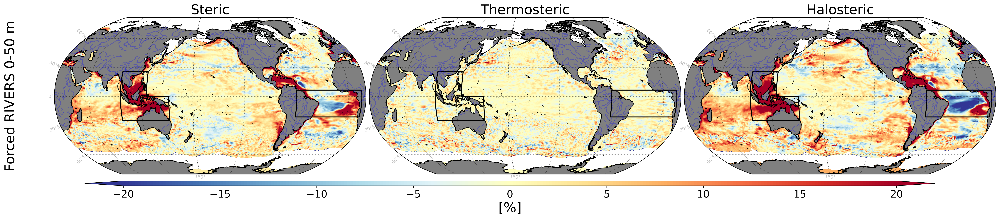

/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anac

FORCED_RIVERS_ste_the_hal_figure6_0_100m.png


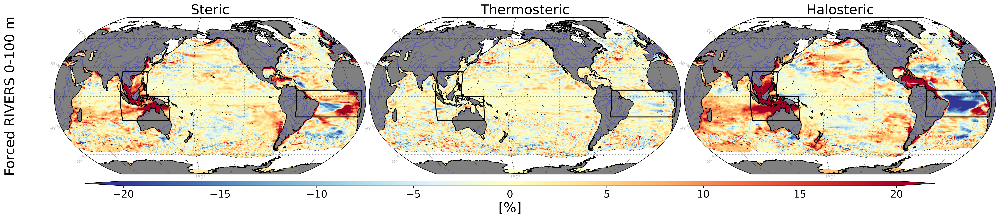

/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anac

FORCED_RIVERS_ste_the_hal_figure6_0_300m.png


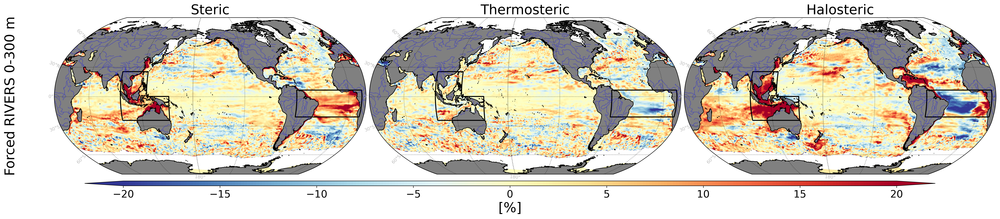

/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anac

FORCED_RIVERS_ste_the_hal_figure6_0_700m.png


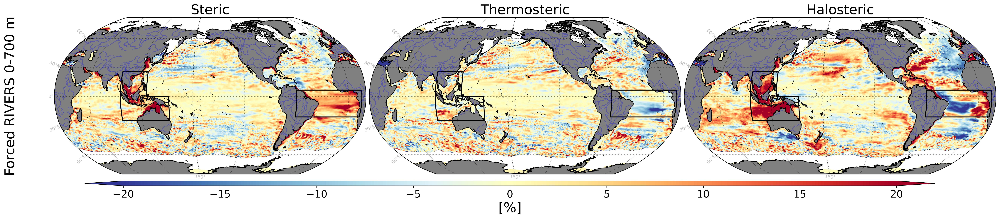

/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
/gpfslocalsup/pub/anac

FORCED_RIVERS_ste_the_hal_figure6_0_2000m.png


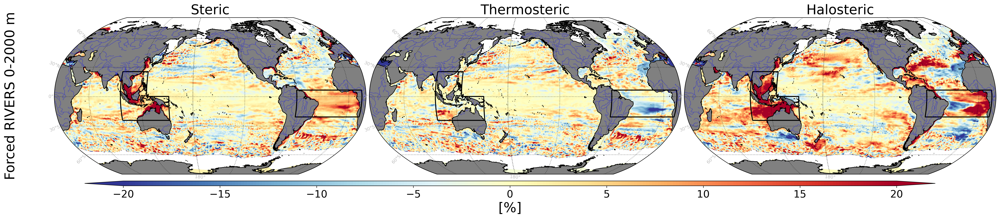

In [24]:
for dep in ["50","100","300","700","2000"]:
    plot_figure(dep)